In [2]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.signal import fftconvolve
import IPython
import pyroomacoustics as pra
from IPython.display import Image

In [10]:
fs, signal = wavfile.read("../data/lemon.wav")
signal = signal[:,0]
print('Sampling rate :', fs, 'Hz')
print("Original WAV:")
IPython.display.Audio(signal, rate = fs)

Sampling rate : 44100 Hz
Original WAV:


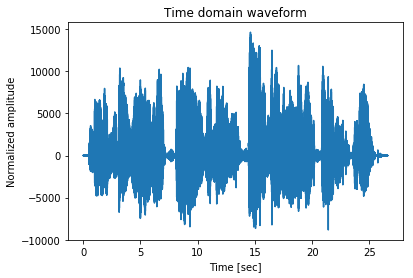

In [11]:
t = np.arange(len(signal))/fs
plt.title('Time domain waveform')
plt.xlabel('Time [sec]')
plt.ylabel('Normalized amplitude')
plt.plot(t,signal)
plt.show()

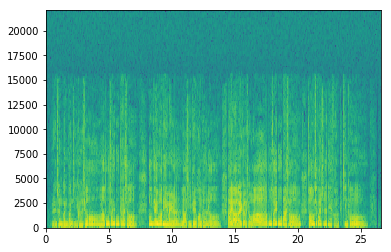

In [12]:
plt.specgram(signal, NFFT=256, Fs =fs);

In [13]:
def freqDelay(signal, fshift, fs):
    
    shift = int(fshift/fs*len(signal));
    signal_fft = np.fft.rfft(signal);
    signal_fft_rolled = np.roll(signal_fft, shift);
    signal_fft_rolled[0:shift] = 0;
    signal_pitched = np.fft.irfft(signal_fft_rolled)
    
    return signal_pitched

In [14]:
shifted_signal = freqDelay(signal, 200, fs);
IPython.display.Audio(shifted_signal, rate = fs)

In [15]:
signals_summed = signal[0:len(shifted_signal)] + shifted_signal;
IPython.display.Audio(signals_summed, rate = fs)

In [16]:
IPython.display.Audio(signal, rate = fs*1.5)

In [17]:
def time_stretch(signal,alpha):
    '''
    Time stretch signal by a factor alpha. 
    Output will have length alpha times length of the signal.
    '''
    N = int(2**7) 									#frame size
    Hs= int(2**7/8) 								#Synthesis hopsize
    Ha = int(Hs / float(alpha)) 					#Analysis hopsize
    w = np.hanning(2**7) 							#Hanning window
    wscale = sum([i**2 for i in w]) / float(Hs)		#Scaling factor
    L0 = signal.size								#original signal size
    L1 = int(signal.size*alpha)						#output signal size
    
    # Initialization
    signal = np.append(np.zeros(int(len(w))), signal)
    
    time_stretch_signal = np.zeros(int((signal.size)*alpha + signal.size/Ha * alpha))
    idx_synthesis = 0
    idx_analysis = 0
    i = 0
    
    # Loop over frames
    while idx_synthesis <= signal.size - (Hs+N):
        i += 1
        # Get Fourier transform of two consecutive windowed frames    
        X = np.fft.fft(w*signal[idx_synthesis:idx_synthesis+N])
        Xnew = np.fft.fft(w*signal[idx_synthesis+Hs:idx_synthesis+Hs+N])

        if idx_synthesis == 0:
            # First frame is not modified
            Xmod_new = Xnew 

        else:
            # Adapt phase to avoid phase jumps. Xmod contains the modified spectrum of previous frame and 
            # Xmod_new contains the spectrum of the frame we are modifying.
            phi =  np.angle(Xmod) + np.angle(Xnew) - np.angle(X)
            Xmod_new = abs(Xnew) * np.exp(1j*phi)

        #Update parameters
        Xmod = Xmod_new
        time_stretch_signal[idx_analysis:idx_analysis+N] = np.add(time_stretch_signal[idx_analysis:idx_analysis+N], np.real(w*np.fft.ifft(Xmod_new)), 
                                                                  out=time_stretch_signal[idx_analysis:idx_analysis+N], casting="unsafe")
        idx_synthesis = int(idx_synthesis+Ha)		# analysis hop
        idx_analysis += Hs							# synthesis hop

    #Scale and remove tails
    time_stretch_signal = time_stretch_signal / wscale 
    time_stretch_signal = np.delete(time_stretch_signal, range(Hs))
    time_stretch_signal = np.delete(time_stretch_signal, range(L1, time_stretch_signal.size))

    return time_stretch_signal

In [18]:
alpha = 2
pitched_signal = time_stretch(signal,alpha)
IPython.display.Audio(pitched_signal, rate = fs)

In [19]:
alpha = 0.5
pitched_signal = time_stretch(signal,alpha)
IPython.display.Audio(pitched_signal, rate = fs)

In [20]:
alpha = 2
pitched_signal = time_stretch(signal,alpha)
pitched_signal_resample = sp.signal.resample(pitched_signal,len(signal))
IPython.display.Audio(pitched_signal_resample, rate = fs)

C:\Users\user\Anaconda3\lib\site-packages\scipy\signal\signaltools.py:2223: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Y[sl] = X[sl]
C:\Users\user\Anaconda3\lib\site-packages\scipy\signal\signaltools.py:2225: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  Y[sl] = X[sl]
C:\Users\user\Anaconda3\lib\site-packages\scipy\signal\signaltools.py:2230: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[n

In [22]:
alpha = 0.5
pitched_signal = time_stretch(signal,alpha)
pitched_signal_resample = sp.signal.resample(pitched_signal,len(signal))
IPython.display.Audio(pitched_signal_resample, rate = fs)

In [21]:
def time_varying_pitch(signal, fs, intensity, rate):
    '''
    Apply a time varying pitch on signal. 
    Pitch is modulated by a sinusoidal of rate and intensity defined by user.
    '''
    
    #Define parameters according to intensity and rate
    N = int(rate*len(signal)/fs)								#Number of periods of the modulation sine
    overlap = 400												#Overlap size for reconstruction
    safety = 200												#Safety padding length to avoid artifacts at frame beginning
    effective_window = 1000										#Effective frame length
    length_window = effective_window + overlap + 2*safety		#Total frame length (i.e. with padding and overlap)
    n = int(len(signal)/effective_window)						#Number of frames
    fade_in = np.linspace(0,1,overlap)							#Triangle window
    fade_out = np.linspace(1,0,overlap)							#Triangle window
    time_stretch_resample = []									#Empty vector to fill with result
    window_resample = []										#Empty vector to fill with current window result
    delay = 2**6												#Delay applied on the result
    
    #Loop over frames
    for i in range(n):
        
        #Evaluate current value of alpha
        alpha = 1 + intensity*np.sin(2*N*np.pi*i/n)
        
        #Apply time stretch on window
        low_index = i*effective_window
        high_index = i*effective_window + length_window
        time_stretched_window = time_stretch(signal[low_index:high_index],alpha)

        #Delete safety margins
        time_stretched_window = np.delete(time_stretched_window,range(len(time_stretched_window)-int(safety*alpha),len(time_stretched_window)))
        time_stretched_window = np.delete(time_stretched_window,range(0,int(safety*alpha)))
            
        
        #Resample the time stretched audio to get pitch shift, and overlap them
        window_resample = sp.signal.resample(time_stretched_window,effective_window+overlap)
        if i==0:
            time_stretch_resample = window_resample
            #fade out
            time_stretch_resample[effective_window:effective_window+overlap] *= fade_out

        if i>0:
            # fade in - fade out
            window_resample[0:overlap] *= fade_in
            window_resample[effective_window:effective_window+overlap] *= fade_out
            time_stretch_resample[len(time_stretch_resample)-overlap:len(time_stretch_resample)] += window_resample[0:overlap]
            time_stretch_resample = np.append(time_stretch_resample,window_resample[overlap:])
            
    time_stretch_resample = np.append(signal[0:safety-delay],time_stretch_resample)
    return time_stretch_resample

In [25]:
pitched_signal = time_varying_pitch(signal,fs,0.02,1)
IPython.display.Audio(signal[0:min(len(pitched_signal),len(signal))]+pitched_signal[0:min(len(pitched_signal),len(signal))], rate = fs)

In [24]:
def chorus_effect(signal, fs, intensity1, intensity2, rate1, rate2, wet):
    '''
    Apply a chorus effect on signal, return signal with chorus
    '''
    chorus_signal_1 = time_varying_pitch(signal,fs,intensity1,rate1)
    chorus_signal_2 = time_varying_pitch(signal,fs,intensity2,rate2)
    
    return 1/2*wet*chorus_signal_1[0:min(len(chorus_signal_1),len(signal))]+1/2*wet*chorus_signal_2[0:min(len(chorus_signal_1),len(signal))]+ (1-wet)*signal[0:min(len(chorus_signal_1),len(signal))]

In [26]:
chorus = chorus_effect(signal,fs,0.025,0.015,0.9,2.0,0.7)
IPython.display.Audio(chorus,rate = fs)